In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

%matplotlib inline
import seaborn as sns

sns.set(style="ticks", context="talk")
import geopandas as gp

In [2]:
data = pd.read_csv(r"D:\ggrbtops.csv")

In [3]:
data.head()

,API,Latitude,Longitude,KB,GL,TD,Field,Formation_TD,Source,Eocene,...,Bighorn,Gallatin,Gros_Ventre,Flathead,Phosphoria,Weber,Morgan,Lakota,Dinwoody,Pre-Cambrian
0,3722668,41.93522,-109.06578,7374.0,7363,8672,Pine Canyon,Morrison,AVP,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,3722405,41.93538,-109.07474,7320.0,7309,8665,Pine Canyon,Morrison,AVP,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,3722475,41.93469,-109.07522,7320.0,7305,8225,Pine Canyon,Mowry,AVP,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3721112,41.94278,-109.04655,7202.0,7183,8929,Pine Canyon,Morrison,AVP,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,3722452,41.94306,-109.06553,7420.0,7404,8830,Nitchie Gulch,Morrison,AVP,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


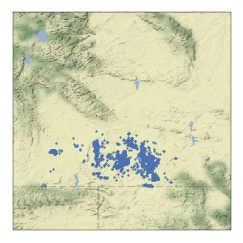

In [26]:
from IPython import display
import cartopy.crs as ccrs
import cartopy.io.img_tiles as cimgt

stamen_terrain = cimgt.StamenTerrain()

ax = plt.axes(projection=ccrs.PlateCarree())
ax.set_extent([-106, -111, 40, 45])
ax.add_image(stamen_terrain, 6)
plt.scatter(data["Longitude"], data["Latitude"], s=3, label="wells")
plt.figure(figsize=(40, 40))

In [7]:
from geopandas import GeoDataFrame
from shapely.geometry import Point
import fiona

# writes the point data to a shapefile in the dir called data.shp
geometry = [Point(xy) for xy in zip(data.Longitude, data.Latitude)]
crs = {"init": "epsg:3732"}  # http://www.spatialreference.org/ref/epsg/2263/
geo_df = GeoDataFrame(data, crs={"init": "epsg:4326"}, geometry=geometry)

geo_df.to_file(driver="ESRI Shapefile", filename="D:\data.shp")
projGeoDF = geo_df.to_crs(crs)

In [8]:
geo_df

,API,Latitude,Longitude,KB,GL,TD,Field,Formation_TD,Source,Eocene,...,Gallatin,Gros_Ventre,Flathead,Phosphoria,Weber,Morgan,Lakota,Dinwoody,Pre-Cambrian,geometry
0,3722668,41.93522,-109.06578,7374.0,7363,8672,Pine Canyon,Morrison,AVP,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-109.06578 41.93522)
1,3722405,41.93538,-109.07474,7320.0,7309,8665,Pine Canyon,Morrison,AVP,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-109.07474 41.93538)
2,3722475,41.93469,-109.07522,7320.0,7305,8225,Pine Canyon,Mowry,AVP,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-109.07522 41.93469)
3,3721112,41.94278,-109.04655,7202.0,7183,8929,Pine Canyon,Morrison,AVP,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-109.04655 41.94278)
4,3722452,41.94306,-109.06553,7420.0,7404,8830,Nitchie Gulch,Morrison,AVP,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-109.06553 41.94306)
5,3721023,41.93510,-109.05629,7354.0,7340,8820,Pine Canyon,Morrison,AVP,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-109.05629 41.9351)
6,3720032,41.95513,-109.08259,7036.0,7022,8483,Nitchie Gulch,Morrison,AVP,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-109.08259 41.95513)
7,3722665,41.95266,-109.08629,7145.0,7138,8621,Nitchie Gulch,Morrison,AVP,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-109.08629 41.95265999999999)
8,3721062,41.94902,-109.05617,7265.0,7250,8849,Nitchie Gulch,Morrison,AVP,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-109.05617 41.94902)
9,3722616,41.95336,-109.10952,6925.0,6910,8660,Nitchie Gulch,Morrison,AVP,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT (-109.10952 41.95336)


In [275]:
xvalues = np.arange(
    np.min(data["Longitude"]), np.max(data["Longitude"].values), 0.01
)
yvalues = np.arange(
    np.min(data["Latitude"]), np.max(data["Latitude"].values), 0.01
)
Xi, Yi = np.meshgrid(xvalues, yvalues)

In [276]:
points = []
for i in range(len(data)):
    points.append((data.iloc[i][2], data.iloc[i][1]))

In [288]:
values = data["Almond"].fillna(0).values

In [289]:
from scipy.interpolate import griddata

grid_z0 = griddata(points, values, (Xi, Yi), method="nearest")
grid_z1 = griddata(points, values, (Xi, Yi), method="linear")
grid_z2 = griddata(points, values, (Xi, Yi), method="cubic")

In [290]:
import matplotlib.colors as colors

C:\Program Files\Anaconda3\lib\site-packages\numpy\ma\core.py:6385: MaskedArrayFutureWarning: In the future the default for ma.minimum.reduce will be axis=0, not the current None, to match np.minimum.reduce. Explicitly pass 0 or None to silence this warning.
  return self.reduce(a)
C:\Program Files\Anaconda3\lib\site-packages\numpy\ma\core.py:6385: MaskedArrayFutureWarning: In the future the default for ma.maximum.reduce will be axis=0, not the current None, to match np.maximum.reduce. Explicitly pass 0 or None to silence this warning.
  return self.reduce(a)


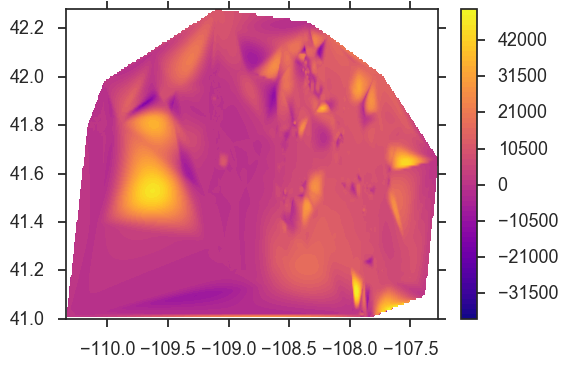

In [291]:
plt.contourf(Xi, Yi, grid_z2, 75, cmap=plt.get_cmap("plasma"))
plt.colorbar(extend="both")

In [238]:
data[
    (data["Longitude"] > -108)
    & (data["Latitude"] < 41.5)
    & (data["GL"] < 7000)
]

,API,Latitude,Longitude,KB,GL,TD,Field,Formation_TD,Source,Alluvium,...,Bighorn,Gallatin,Gros_Ventre,Flathead,Phosphoria,Weber,Morgan,Lakota,Dinwoody,Pre-Cambrian
111,721285,41.209230,-107.682640,6424.0,6408,7235,Robbers Gulch,Almond,RDB,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
112,720443,41.179630,-107.675180,6396.0,6378,9823,Robbers Gulch,Steele,RDB,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
113,705057,41.179925,-107.672533,6387.0,6376,7348,Robbers Gulch,Almond,RDB,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
114,721357,41.188230,-107.673490,6427.0,6415,7350,Robbers Gulch,NaN,RDB,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
115,720513,41.171910,-107.675410,6393.0,6377,10000,Robbers Gulch,Steele,RDB,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
116,721377,41.157630,-107.666340,6379.0,6379,7650,Robbers Gulch,NaN,RDB,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
117,720560,41.158980,-107.673040,6423.0,6419,8175,Robbers Gulch,NaN,RDB,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
118,720738,41.174340,-107.769160,6710.0,6692,9762,NaN,Ericson,RDB,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
119,720319,41.201402,-107.809001,6827.0,6813,10411,Blue Gap,Ericson,RDB,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
121,721232,41.172380,-107.884830,6813.0,6799,11200,Big Ridge,Almond,RDB,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


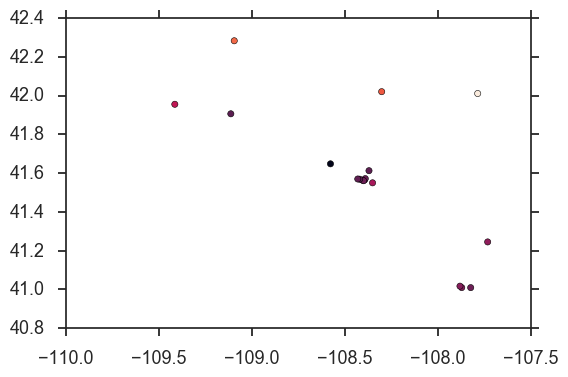

In [310]:
formationTops = data.columns.values[9:]
for formation in formationTops:
    df = data[data[formation].notnull()]

    xvalues = np.arange(
        np.min(df["Longitude"]), np.max(df["Longitude"].values), 0.01
    )
    yvalues = np.arange(
        np.min(df["Latitude"]), np.max(df["Latitude"].values), 0.01
    )
    Xi, Yi = np.meshgrid(xvalues, yvalues)

In [364]:
df = data[data["Almond"].notnull()]
xvalues = np.arange(
    np.min(df["Longitude"]), np.max(df["Longitude"].values), 0.001
)
yvalues = np.arange(
    np.min(df["Latitude"]), np.max(df["Latitude"].values), 0.001
)
Xi, Yi = np.meshgrid(xvalues, yvalues)
points = []
for i in range(len(df)):
    points.append((df.iloc[i][2], df.iloc[i][1]))

In [365]:
values = df["Almond"].values

In [366]:
grid_z2 = griddata(points, values, (Xi, Yi), method="cubic")

C:\Program Files\Anaconda3\lib\site-packages\numpy\ma\core.py:6385: MaskedArrayFutureWarning: In the future the default for ma.minimum.reduce will be axis=0, not the current None, to match np.minimum.reduce. Explicitly pass 0 or None to silence this warning.
  return self.reduce(a)
C:\Program Files\Anaconda3\lib\site-packages\numpy\ma\core.py:6385: MaskedArrayFutureWarning: In the future the default for ma.maximum.reduce will be axis=0, not the current None, to match np.maximum.reduce. Explicitly pass 0 or None to silence this warning.
  return self.reduce(a)


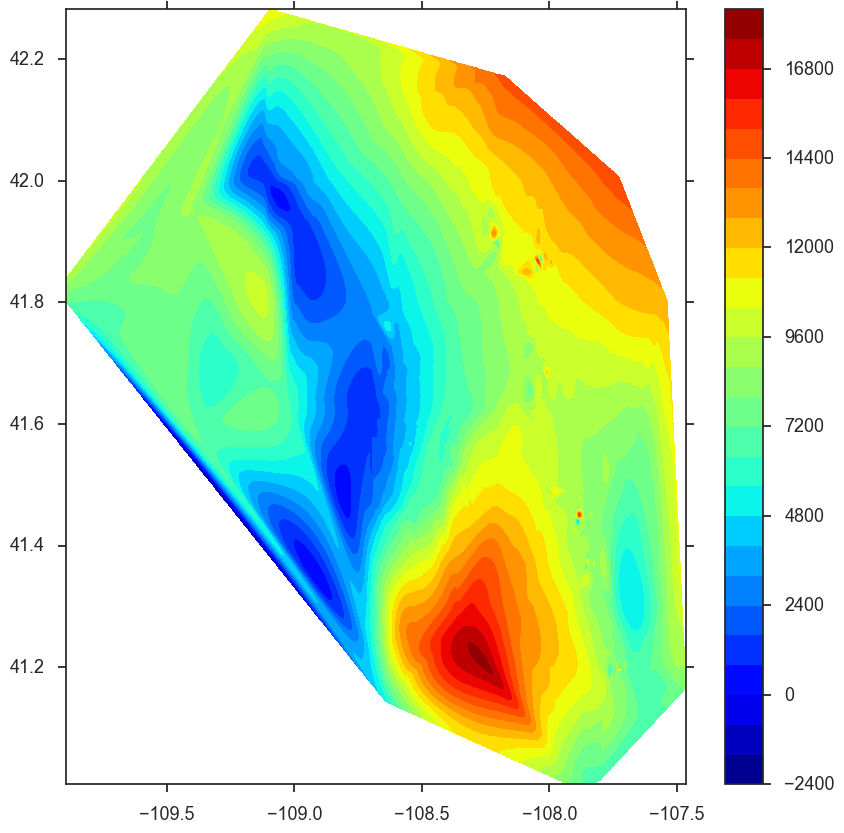

In [412]:
plt.contourf(Xi, Yi, grid_z2, 30, cmap=plt.get_cmap("jet"))
plt.colorbar(extend="both")
plt.rcParams["figure.figsize"] = [10, 10]

In [372]:
import mpld3

In [413]:
fig, ax = plt.subplots(subplot_kw=dict(axisbg="#EEEEEE"))
contour = ax.contourf(Xi, Yi, grid_z2, 30, cmap=plt.get_cmap("jet"))

scatter = ax.scatter(*zip(*points))

ax.grid(color="white", linestyle="solid")

ax.set_title("Almond", size=20)

labels = df["API"].tolist()
tooltip = mpld3.plugins.PointLabelTooltip(scatter, labels=labels)
mpld3.plugins.connect(fig, tooltip)

mpld3.display(fig)

C:\Program Files\Anaconda3\lib\site-packages\numpy\ma\core.py:6385: MaskedArrayFutureWarning: In the future the default for ma.minimum.reduce will be axis=0, not the current None, to match np.minimum.reduce. Explicitly pass 0 or None to silence this warning.
  return self.reduce(a)
C:\Program Files\Anaconda3\lib\site-packages\numpy\ma\core.py:6385: MaskedArrayFutureWarning: In the future the default for ma.maximum.reduce will be axis=0, not the current None, to match np.maximum.reduce. Explicitly pass 0 or None to silence this warning.
  return self.reduce(a)


In [393]:
labels = ["point {0}".format(i + 1) for i in range(N)]

In [395]:
type(labels)

list

In [401]:
df["API"].tolist()

['3720951',
 '3721067',
 '3723213',
 '3721109',
 '3720327',
 '3721279',
 '3721046',
 '3721228',
 '3721329',
 '3721839',
 '721285',
 '720443',
 '705057',
 '721357',
 '720513',
 '721377',
 '720560',
 '720738',
 '720319',
 '720779',
 '721232',
 '720781',
 '720697',
 '720514',
 '720405',
 '720375',
 '720657',
 '720985',
 '720828',
 '720218',
 '720186',
 '720206',
 '720795',
 '720984',
 '720644',
 '720989',
 '721305',
 '721304',
 '721319',
 '720694',
 '720996',
 '721320',
 '721286',
 '720731',
 '720382',
 '720646',
 '720942',
 '720950',
 '720619',
 '720355',
 '720691',
 '720700',
 '720682',
 '721067',
 '720647',
 '720680',
 '3722029',
 '3705163',
 '721325',
 '720811',
 '720997',
 '720817',
 '720986',
 '720390',
 '720986',
 '720712',
 '720215',
 '720377',
 '720314',
 '720345',
 '720373',
 '720374',
 '720352',
 '720122',
 '720378',
 '720648',
 '720271',
 '720785',
 '720431',
 '720432',
 '720494',
 '720915',
 '720297',
 '721396',
 '3722185',
 '3721785',
 '3721071',
 '3723031',
 '3722924',
 '37